# **Conversión de imágenes a forma de pintura**
### Omitir este proceso si se encuentran las 2 carpetas de img_to_paint e input_images

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os
import random
from PIL import Image
import torch

import tensorflow as tf
from tqdm import tqdm
from tensorflow.keras.preprocessing.image import img_to_array

import datetime
import time

from IPython.display import clear_output
import shutil

In [2]:
# Verificar si la GPU está disponible
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Usando el dispositivo: {device}")
print("Nombre de GPU:", torch.cuda.get_device_name(0))

Usando el dispositivo: cuda
Nombre de GPU: NVIDIA GeForce GTX 1650


In [3]:
# Generamos una copia del archivo de imgs_original para la modificación de estas
carpeta_original = 'imgs_original'
carpeta_destino = 'imgs_to_paint'

# Clonar la carpeta completa
shutil.copytree(carpeta_original, carpeta_destino, dirs_exist_ok=True)

'imgs_to_paint'

In [4]:
# !git clone "https://github.com/DonLuisM/Pix2Pix.git"

In [5]:
file_data = 'imgs_to_paint'


In [6]:
SIZE = 256
imágenes = 0

# Iterar sobre cada archivo en el directorio
for filename in sorted(os.listdir(file_data)):
    # Construir la ruta completa del archivo
    file_path = os.path.join(file_data, filename)

    # Verificar si es un archivo de imagen
    if os.path.isfile(file_path) and filename.endswith(('.jpg', '.png', '.jpeg')):
        imágenes += 1
        # Abrir la imagen con Pillow
        image = Image.open(file_path)
        original_size = image.size

        # Borrar si no es del tamaño deseado
        if original_size != (SIZE, SIZE):
          # Redimensionar imagen
          resized_img = image.resize((SIZE, SIZE), Image.LANCZOS)
          resized_img = resized_img.convert('RGB')
          resized_img.save(file_path) # Sobrescribir la imagen original con la redimensionada
          print(f"Imagen {filename}: tamaño original{image.size}, tamaño redimensionado {resized_img.size}")
        else:
          print(f"Imagen {filename}: ya tiene el tamaño correcto {original_size}")

print(f'\nTotal de imágenes es de: {imágenes}')

Imagen Bigben_1.jpg: tamaño original(980, 1275), tamaño redimensionado (256, 256)
Imagen Bigben_2.jpg: tamaño original(650, 433), tamaño redimensionado (256, 256)
Imagen Bigben_3.jpg: tamaño original(768, 512), tamaño redimensionado (256, 256)
Imagen Bigben_4.jpg: tamaño original(742, 500), tamaño redimensionado (256, 256)
Imagen Bigben_5.jpg: tamaño original(856, 1280), tamaño redimensionado (256, 256)
Imagen Bridge_1.jpg: tamaño original(660, 440), tamaño redimensionado (256, 256)
Imagen Bridge_2.jpg: tamaño original(1600, 810), tamaño redimensionado (256, 256)
Imagen Bridge_3.jpg: tamaño original(640, 360), tamaño redimensionado (256, 256)
Imagen Bridge_4.jpg: tamaño original(1000, 750), tamaño redimensionado (256, 256)
Imagen Bridge_5.jpg: tamaño original(1920, 1283), tamaño redimensionado (256, 256)
Imagen Can_1.jpg: tamaño original(700, 330), tamaño redimensionado (256, 256)
Imagen Can_2.jpg: tamaño original(700, 467), tamaño redimensionado (256, 256)
Imagen Can_3.jpg: tamaño ori

In [7]:
# Función para rotar imágenes
def rotation_imgs(img):
  angle=20
  angle = int(random.uniform(-angle, angle))
  h, w = img.shape[:2]
  M = cv2.getRotationMatrix2D((int(w/2), int(h/2)), angle, 1)
  img = cv2.warpAffine(img, M, (w, h))
  return img

# Función para hacer en movimiento en eje x
def horizontal_flip(img):
  flip = cv2.flip(img,1)
  return flip

# Función para un difuminado gaussiano (valores impares del kernel)
def blur_imgs(img):
  blur = cv2.GaussianBlur(img,(5,5),0)
  return blur

color_img = []
path = file_data
files = sorted(os.listdir(path), key=lambda x: x.lower())

for i in tqdm(files):
  img_path = os.path.join(path, i)
  img = cv2.imread(img_path, 1)
  if img is not None:
      # OpenCV lee las imágenes en formato BGR, por lo que debemos convertirlo a RGB
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      img = img.astype('float32') / 255.0

      ##! rotación img y Añadir la imagen procesada a la lista
      img_rotate = rotation_imgs(img)
      color_img.append(img_to_array(img_rotate))

      # Guardar la imagen aumentada
      img_rotate = (img_rotate * 255).astype('uint8')
      output_file_rotate = os.path.join(path, f"Aug_rotate_{i}")
      cv2.imwrite(output_file_rotate, cv2.cvtColor(img_rotate, cv2.COLOR_RGB2BGR))

      ##! Rotación hotizontal y añadir imagen procesada
      img_flip = horizontal_flip(img)
      color_img.append(img_to_array(img_flip))

      # Guardar la imagen aumentada
      img_flip = (img_flip * 255).astype('uint8')
      output_file_flip = os.path.join(path, f"Aug_flip_{i}")
      cv2.imwrite(output_file_flip, cv2.cvtColor(img_flip, cv2.COLOR_RGB2BGR))

      ##! Desenfoque Gaussiano y añadir la imagen
      img_blur = blur_imgs(img)
      color_img.append(img_to_array(img_blur))

      # Guardar la imagen aumentada
      img_blur = (img_blur * 255).astype('uint8')
      output_file_blur = os.path.join(path, f"Aug_blur_{i}")
      cv2.imwrite(output_file_blur, cv2.cvtColor(img_blur, cv2.COLOR_RGB2BGR))

# Convertir la lista de imágenes a un array NumPy
color_img = np.array(color_img)
print(f'Tamaño de color_img: {color_img.shape}')

100%|██████████| 150/150 [00:03<00:00, 39.07it/s]


Tamaño de color_img: (450, 256, 256, 3)


In [8]:
def oil_painting_effect(image_path):
    # Cargar la imagen
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Aplicar filtro bilateral para suavizar la imagen y reducir el ruido
    img_smoothed = cv2.bilateralFilter(img, d=7, sigmaColor=95, sigmaSpace=95)

    # Convertir la imagen a escala de grises
    gray = cv2.cvtColor(img_smoothed, cv2.COLOR_BGR2GRAY)

    # Aplicar detección de bordes usando el detector de bordes de Canny
    edges = cv2.Canny(gray, 95, 190)

    # Invertir los bordes
    edges = cv2.bitwise_not(edges)

    # Crear una imagen en blanco con las mismas dimensiones que la imagen original
    edges_colored = cv2.cvtColor(edges, cv2.COLOR_GRAY2BGR)

    # Combinar la imagen suavizada con los bordes invertidos para obtener el efecto de pintura
    painting = cv2.bitwise_and(img_smoothed, edges_colored)

    return painting

# ! Función que da error por el xphoto
# def oil_painting_effect(image_path):
#     # Cargar la imagen
#     img = cv2.imread(image_path)
#     img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)

#     # Aplicar filtro bilateral para suavizar la imagen y reducir el ruido
#     img_smoothed = cv2.bilateralFilter(img, d=7, sigmaColor=95, sigmaSpace=95)
#     img_smoothed = cv2.xphoto.oilPainting(img_smoothed, 8, 3)

#     # Convertir la imagen a escala de grises
#     gray = cv2.cvtColor(img_smoothed, cv2.COLOR_BGR2GRAY)

#     # Aplicar detección de bordes usando el detector de bordes de Canny
#     edges = cv2.Canny(gray, 95, 190)

#     # Invertir los bordes
#     edges = cv2.bitwise_not(edges)

#     # Crear una imagen en blanco con las mismas dimensiones que la imagen original
#     edges_colored = cv2.cvtColor(edges, cv2.COLOR_GRAY2BGR)

#     # Combinar la imagen suavizada con los bordes invertidos para obtener el efecto de pintura
#     painting = cv2.bitwise_and(img_smoothed, edges_colored)

#     return painting


In [9]:
# Crear una nueva carpeta para almacenar las imágenes procesadas
output_folder = 'input_images'
os.makedirs(output_folder, exist_ok=True)

# Lista para almacenar las imágenes procesadas
input_images = []

# Iterar sobre cada archivo en el directorio
for filename in sorted(os.listdir(file_data), key=lambda x: x.lower(), reverse=True):
    # Construir la ruta completa del archivo
    file_path = os.path.join(file_data, filename)

    # Verificar si es un archivo de imagen
    if os.path.isfile(file_path) and filename.endswith(('.jpg', '.png', '.jpeg')):
        # Aplicar el efecto de pintura
        painting = oil_painting_effect(file_path)

        # Agregar la imagen procesada al arreglo
        input_images.append(painting)

        # Guardar la imagen procesada en la nueva carpeta
        output_path = os.path.join(output_folder, filename)
        cv2.imwrite(output_path, cv2.cvtColor(painting, cv2.COLOR_RGB2BGR))

        # Mostrar la imagen resultante
        # plt.imshow(painting)
        # plt.title(f'Imagen {filename}')
        # plt.show()

# **Proceso de la cGAN PIX2PIX**

En una cGAN,se hace bajo ciertas condiciones o reglas. El generador recibe una "instrucción" que le indica qué tipo de imagen debe crear. Las redes generativas antagonicas cuentan con su generador y discriminador

In [44]:
# Procesamiento de las imágenes y almacenamiento (input and ground)
# Definir el tamaño de la imagen
SIZE = 256
IMG_HEIGHT = SIZE
IMG_WIDTH = SIZE

# Cargar imágenes en forma de pintura (input)
painted_img = []
path = 'input_images'
files = sorted(os.listdir(path))

for i in tqdm(files):
  img_path = os.path.join(path, i)
  img = cv2.imread(img_path, 1)
  if img is not None:
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      # Redimensionar imagen
      img = cv2.resize(img, (SIZE, SIZE))
      img = img.astype('float32') / 255.0
      painted_img.append(img_to_array(img))

painted_img = np.array(painted_img)

# Cargar imágenes en forma de referencia (ground)
color_img = []
path = 'imgs_to_paint'
files = sorted(os.listdir(path))

for i in tqdm(files):
  img_path = os.path.join(path, i)
  img = cv2.imread(img_path, 1)
  if img is not None:
      img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
      # Redimensionar imagen
      img = cv2.resize(img, (SIZE, SIZE))
      img = img.astype('float32') / 255.0
      color_img.append(img_to_array(img))

color_img = np.array(color_img)

print(f'Tamaño de painted_img: {painted_img.shape}')
print(f'Tamaño de color_img: {color_img.shape}')

100%|██████████| 600/600 [00:01<00:00, 305.28it/s]


Tamaño de painted_img: (600, 256, 256, 3)
Tamaño de color_img: (600, 256, 256, 3)


### Si se tienen las carpetas de imgs_to_paint e input_images, se puede saltar hasta este paso para dividir las imagenes para train y test con su batchsize

In [45]:
# Crear los conjuntos de datos de TensorFlow ()
train_color_dataset = tf.data.Dataset.from_tensor_slices(np.array(color_img[:500])).batch(1) #16
train_painted_dataset = tf.data.Dataset.from_tensor_slices(np.array(painted_img[:500])).batch(1)

test_color_dataset = tf.data.Dataset.from_tensor_slices(np.array(color_img[500:])).batch(1) #4
test_painted_dataset = tf.data.Dataset.from_tensor_slices(np.array(painted_img[500:])).batch(1)

In [46]:
example_color = next(iter(train_color_dataset))
example_painted = next(iter(train_painted_dataset))

In [47]:
def plot_images(a):
    # Get batches of examples *before* the loop
    example_color_batches = list(train_color_dataset)
    example_painted_batches = list(train_painted_dataset)

    for i in range(min(a, len(example_color_batches))):
        # Access the pre-fetched batches
        example_color = example_color_batches[i]
        example_painted = example_painted_batches[i]

        plt.figure(figsize = (10,10))
        plt.subplot(121)
        plt.title(f'Imagen normal')
        plt.imshow(example_color[0])

        plt.subplot(122)
        plt.title('Imagen en pintura')
        plt.imshow(example_painted[0])

In [48]:
plot_images(2)

KeyboardInterrupt: 

In [15]:
OUTPUT_CHANNELS = 3

In [16]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())  #     if apply_instancenorm:
                                                      #         result.add(tfa.layers.InstanceNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)  # HeNormal() ->Añadir normalización a las capas

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [17]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)  ### Podría reducir la profundidad de las capas
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)  # HeNormal()
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])
    # Add residual connection
    # x = tf.keras.layers.Add()([x, tf.keras.layers.Conv2D(x.shape[-1], 1, padding='same')(skip)])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

In [ ]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

You must install pydot (`pip install pydot`) for `plot_model` to work.


In [19]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

In [ ]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

You must install pydot (`pip install pydot`) for `plot_model` to work.


In [21]:
LAMBDA = 100

In [22]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [23]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [24]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_2=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [25]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [26]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.84488744..0.77385664].


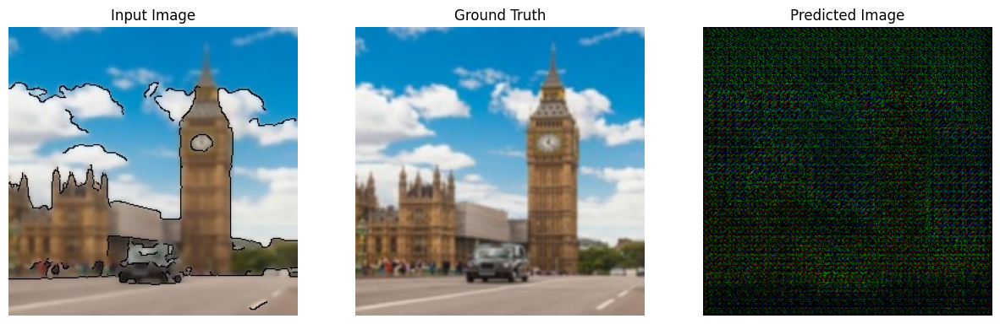

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85351545..0.81846696].


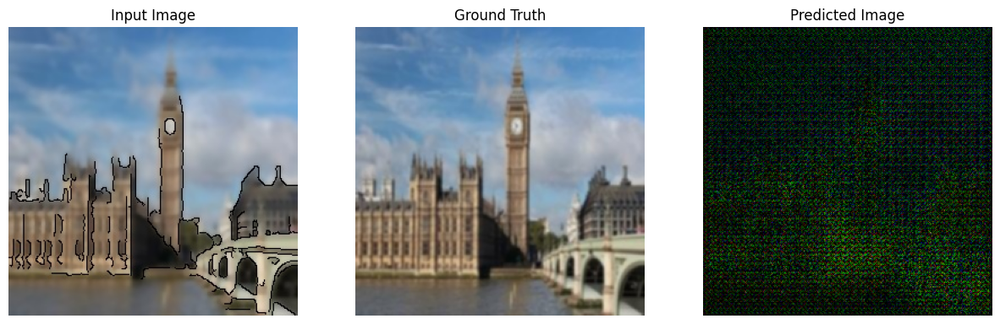

In [ ]:
for example_input, example_target in tf.data.Dataset.zip((train_painted_dataset, train_color_dataset)).take(2):
  generate_images(generator, example_input, example_target)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.86922204..0.79084784].


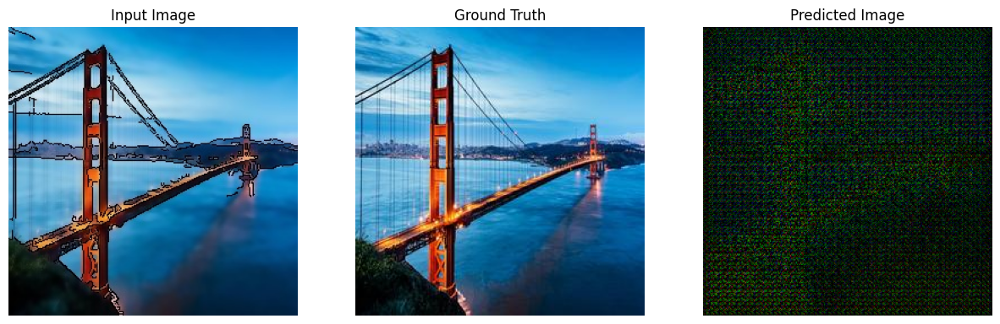

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85024756..0.8470301].


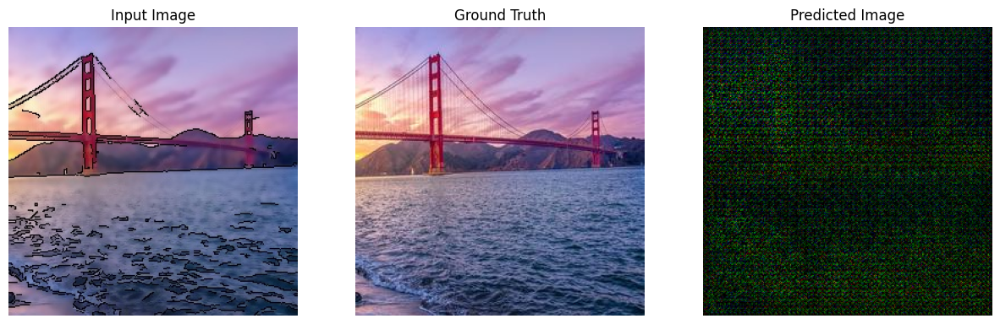

In [ ]:
for example_input, example_target in tf.data.Dataset.zip((test_painted_dataset, test_color_dataset)).take(2):
  generate_images(generator, example_input, example_target)

In [29]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [30]:
@tf.function
def train_step(input_image, target, step, summary_writer):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [31]:
def fit(train_ds, test_ds, steps):
    example_input, example_target = next(iter(test_ds.take(1)))
    start = time.time()

    for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
        if (step) % 1000 == 0:
            clear_output(wait=True)

            if step != 0:
                print(f'Time taken for 1000 steps: {time.time() - start:.2f} sec\n')

            start = time.time()

            generate_images(generator, example_input, example_target)
            print(f"Step: {step // 1000}k")

        train_step(input_image, target, step, summary_writer)

        # Training step
        if (step + 1) % 10 == 0:
            print('.', end='', flush=True)

        # Save (checkpoint) the model every 5k steps
        if (step + 1) % 5000 == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)


In [32]:
%reload_ext tensorboard
%tensorboard --logdir {log_dir}

Reusing TensorBoard on port 6006 (pid 2380), started 12 days, 22:38:22 ago. (Use '!kill 2380' to kill it.)

In [33]:
# Crear los datasets combinados
train_dataset = tf.data.Dataset.zip((train_painted_dataset, train_color_dataset))
test_dataset = tf.data.Dataset.zip((test_painted_dataset, test_color_dataset))

Time taken for 1000 steps: 1454.95 sec



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.24891485..0.9844049].


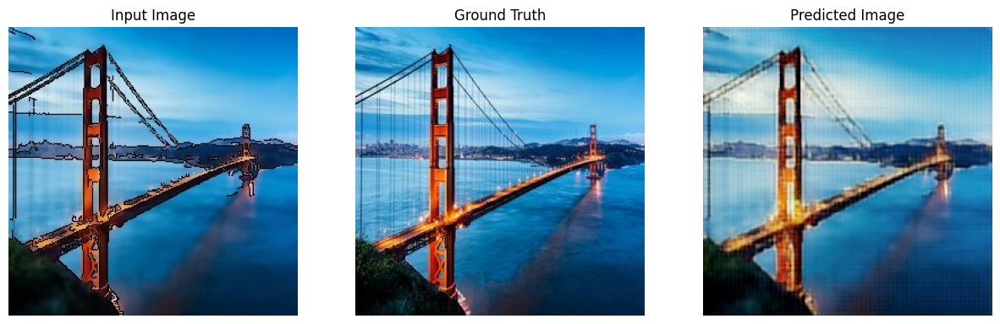

Step: 4k
....................................................................................................

In [ ]:
fit(train_dataset, test_dataset, steps=5000)

In [ ]:
# Restoring the latest checkpoint in checkpoint_dir
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [36]:
%tensorboard --logdir {log_dir}

Reusing TensorBoard on port 6006 (pid 2380), started 13 days, 0:38:15 ago. (Use '!kill 2380' to kill it.)

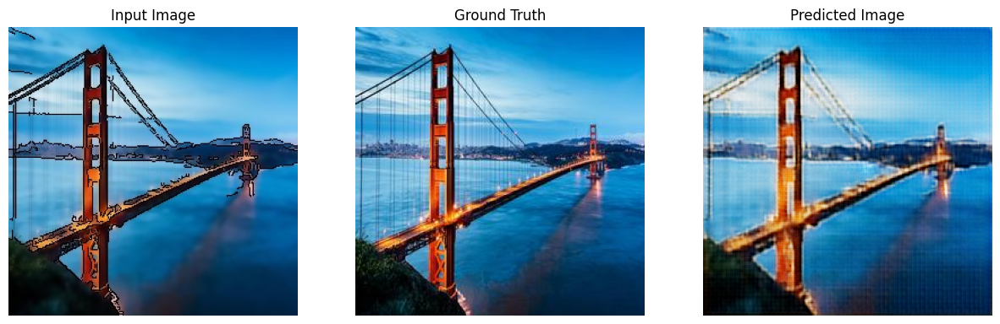

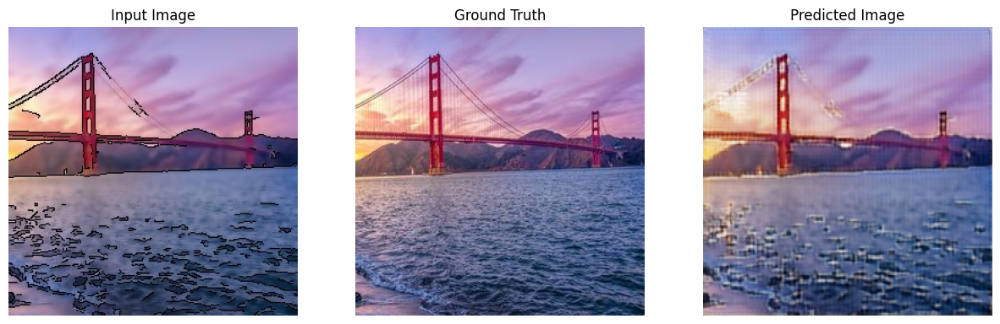

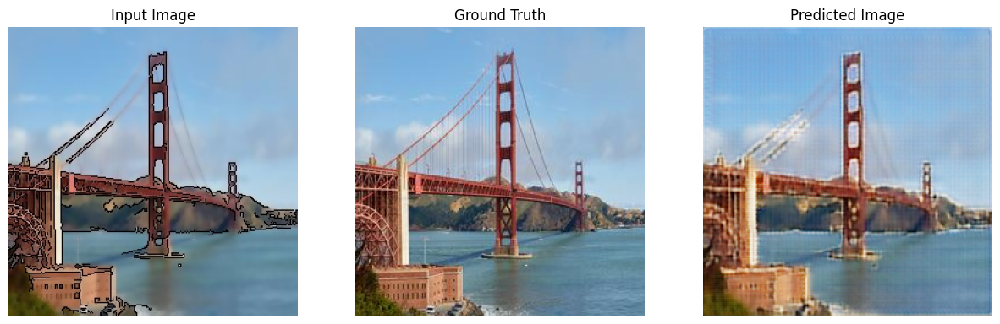

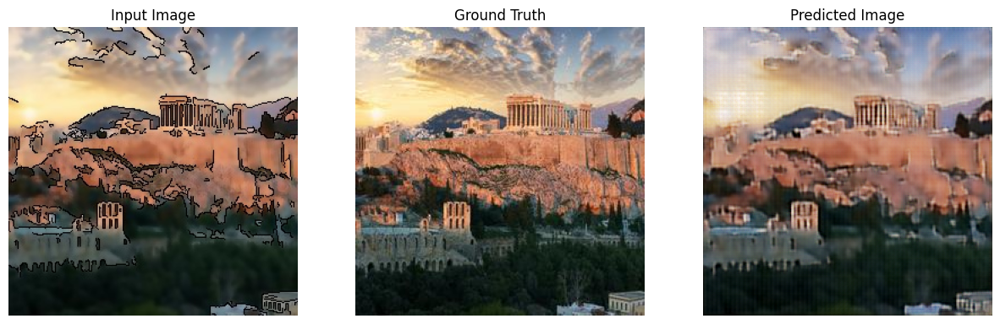

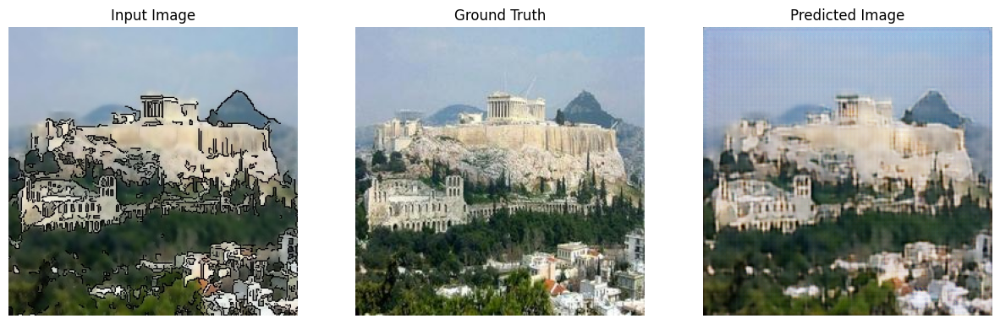

In [ ]:
# Run the trained model on a few examples from the test set
for example_input, example_target in test_dataset.take(5):
  generate_images(generator, example_input, example_target)

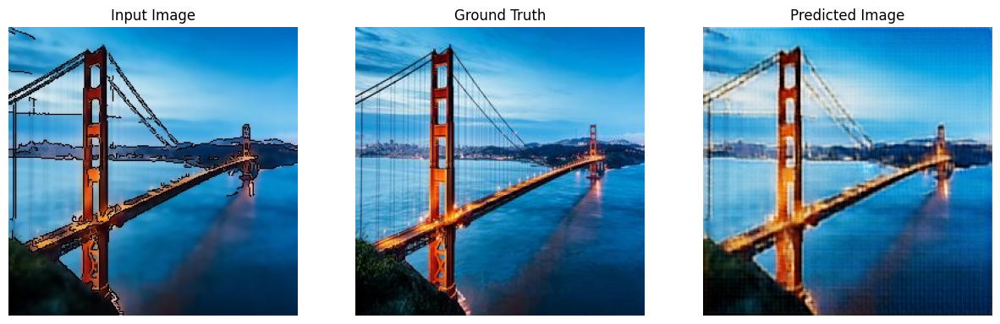

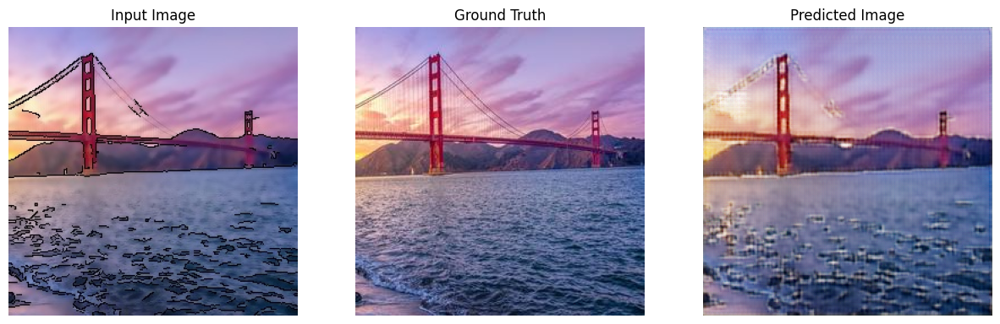

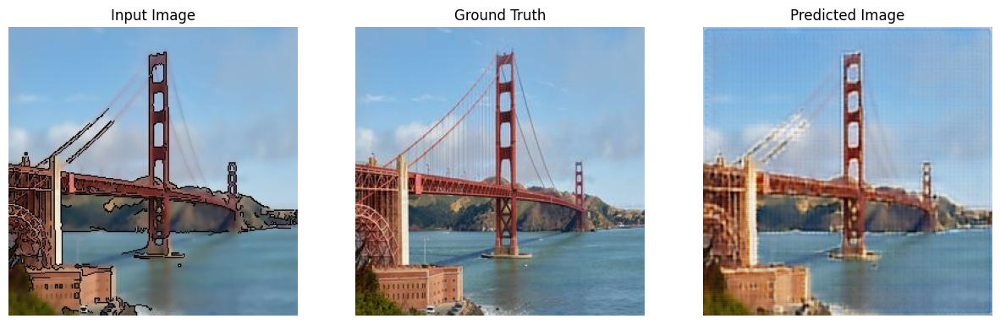

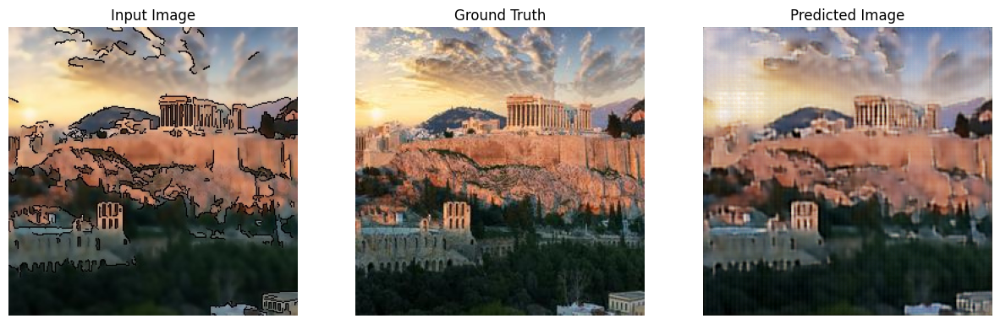

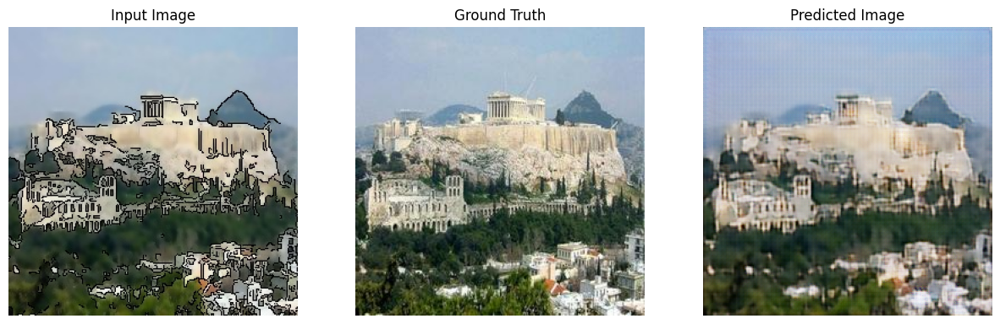

In [43]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i])
    plt.axis('off')
  plt.show()

for example_input, example_target in test_dataset.take(5):
  generate_images(generator, example_input, example_target)